In [1]:
import pandas as pd
import scanpy as sc
import seaborn as sb
import numpy as np

from matplotlib import rcParams
import matplotlib.pyplot as plt

In [2]:
import sys
sys.path.append('../..')
import tcr_embedding.utils_training as utils

In [5]:
db_covid = pd.read_csv('../../data/databases/CoV-AbDab_310122.csv')

In [48]:
adata.obs['junction_aa_heavy_trimmed'] = adata.obs['junction_aa_heavy'].apply(lambda x: x[1:-1])
adata.obs['cdr3h_in_db'] = adata.obs['junction_aa_heavy_trimmed'].apply(lambda x: x in db_covid['CDRH3'].values)
adata.obs['cdr3h_in_db'] = adata.obs['cdr3h_in_db'].astype(str)
adata.obs['cdr3h_in_db'].value_counts()

False    38782
True        11
Name: cdr3h_in_db, dtype: int64

In [49]:
adata.obs['junction_aa_light_trimmed'] = adata.obs['junction_aa_light'].apply(lambda x: x[1:-1])
adata.obs['cdr3l_in_db'] = adata.obs['junction_aa_light_trimmed'].apply(lambda x: x in db_covid['CDRL3'].values)
adata.obs['cdr3l_in_db'] = adata.obs['cdr3l_in_db'].astype(str)
adata.obs['cdr3l_in_db'].value_counts()

False    21995
True     16798
Name: cdr3l_in_db, dtype: int64

In [39]:
def load_model(adata, model, weight):
    path_model = f'saved_models/journal/Haniffa_bcells/'
    path_model += f'haniffa_bc_{model}_{weight}.pt'
    model = utils.load_model(adata, path_model)
    return model
    

In [40]:
adata = utils.load_data('haniffa_bcr')
adata.obs['set'] = 'train'

In [41]:
metadata = ['initial_clustering', 'Sex', 
            'Age', 'Ethnicity', 'Swab_result', 'Status', 'Smoker', 'Status_on_day_collection',
            'Status_on_day_collection_summary', 'Status_3_days_post_collection', 
            'Status_7_days_post_collection', 'Days_from_onset', 'Site', 
            'Worst_Clinical_Status', 'Outcome', 'initial_clustering_B', 'celltype_B_v2', 
            'status', 'clonotype', 'tnf_signaling_score', 'bcr_signaling_act_score',
           'bcr_signaling_inh_score', 'cdr3l_in_db', 'cdr3h_in_db'
]

... storing 'set' as categorical


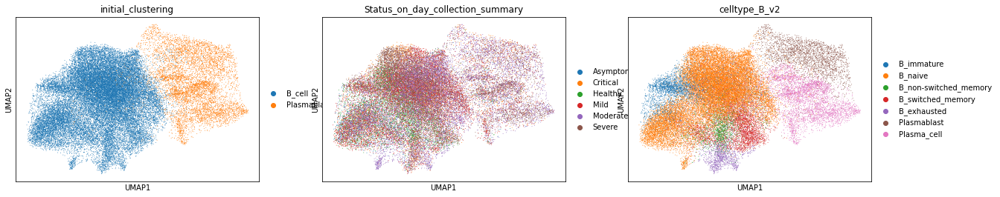

In [42]:
sc.pp.neighbors(adata)
sc.tl.umap(adata)
sc.pl.umap(adata, color=['initial_clustering', 'Status_on_day_collection_summary', 'celltype_B_v2'])

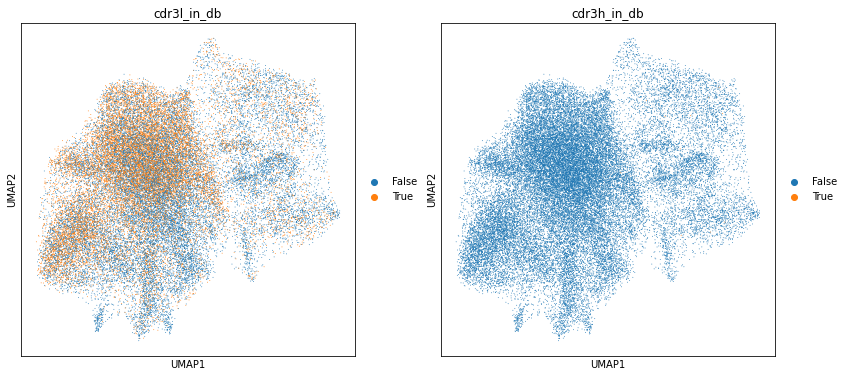

In [56]:
sc.pl.umap(adata, color=['cdr3l_in_db', 'cdr3h_in_db',], ncols=3)

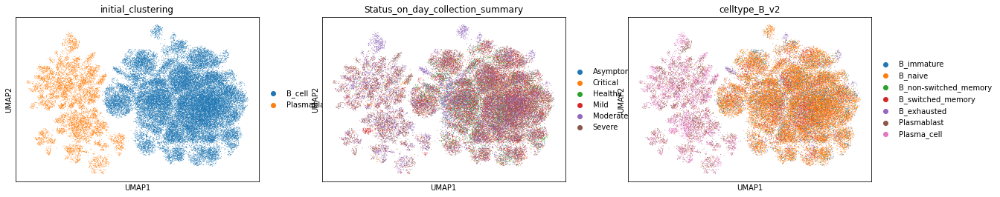

In [51]:
model_rna = load_model(adata, 'rna', 1)
latent_rna = model_rna.get_latent(adata, metadata=metadata, return_mean=True)
sc.pp.neighbors(latent_rna)

sc.tl.umap(latent_rna, min_dist=1)
sc.pl.umap(latent_rna, color=['initial_clustering', 'Status_on_day_collection_summary', 'celltype_B_v2'])

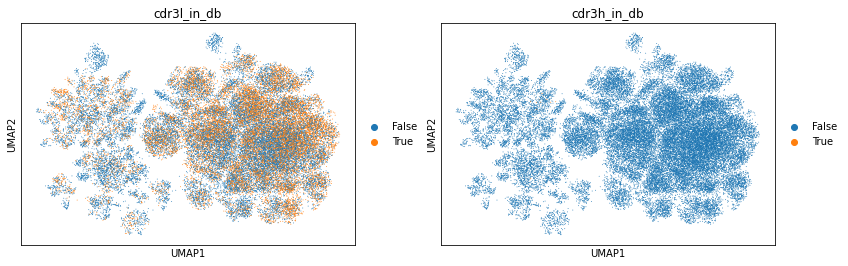

In [52]:
sc.pl.umap(latent_rna, color=['cdr3l_in_db', 'cdr3h_in_db'], ncols=3)

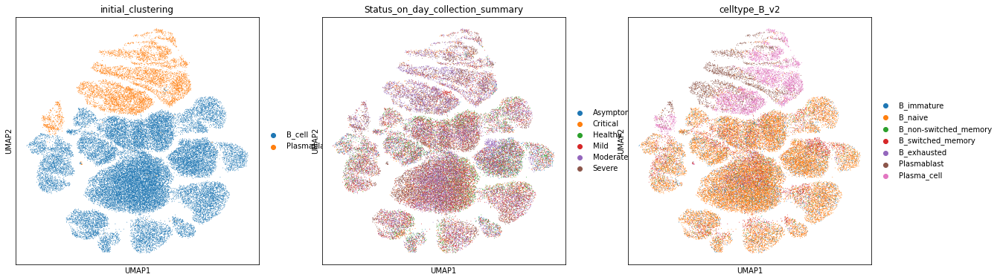

In [53]:
rcParams['figure.figsize'] = (6, 6)

model_moe = load_model(adata, 'moe', 10)
latent_moe = model_moe.get_latent(adata, metadata=metadata, return_mean=True)
sc.pp.neighbors(latent_moe)

latent_moe_tmp = latent_moe.copy()
sc.tl.umap(latent_moe, min_dist=1)
sc.pl.umap(latent_moe, color=['initial_clustering', 'Status_on_day_collection_summary', 'celltype_B_v2'])

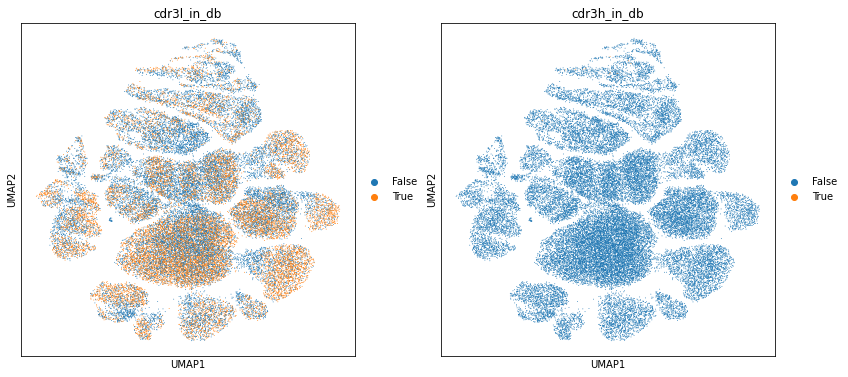

In [54]:
sc.pl.umap(latent_moe, color=['cdr3l_in_db', 'cdr3h_in_db'], ncols=3)

model_tcr = load_model(adata, 'tcr', 1)
latent_tcr = model_tcr.get_latent(adata, metadata=metadata, return_mean=True)
sc.pp.neighbors(latent_tcr)
sc.tl.umap(latent_tcr)
for col in metadata:
    sc.pl.umap(latent_tcr, color=col)

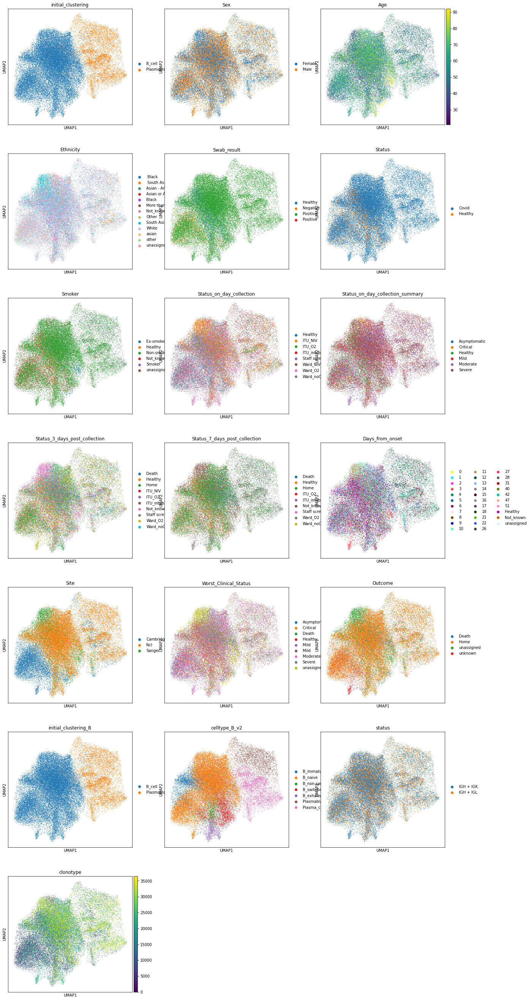

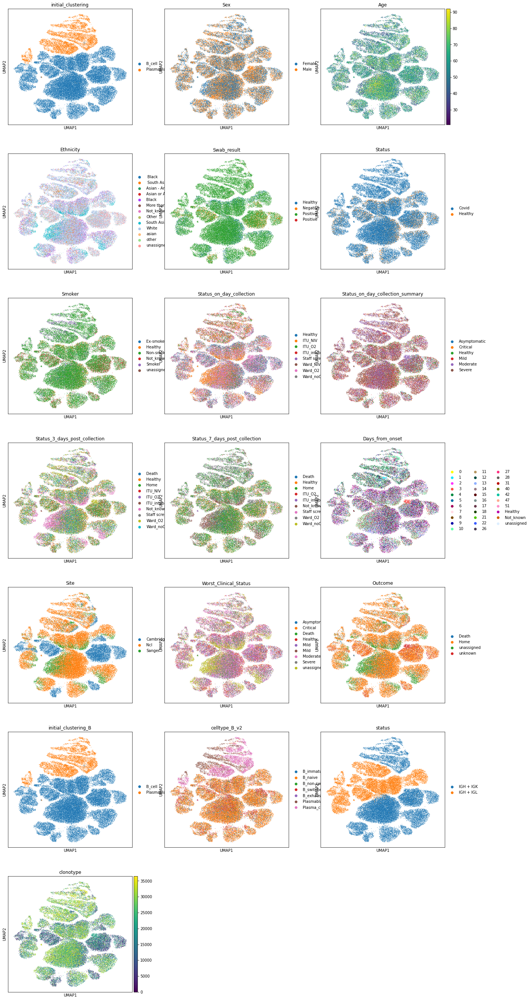

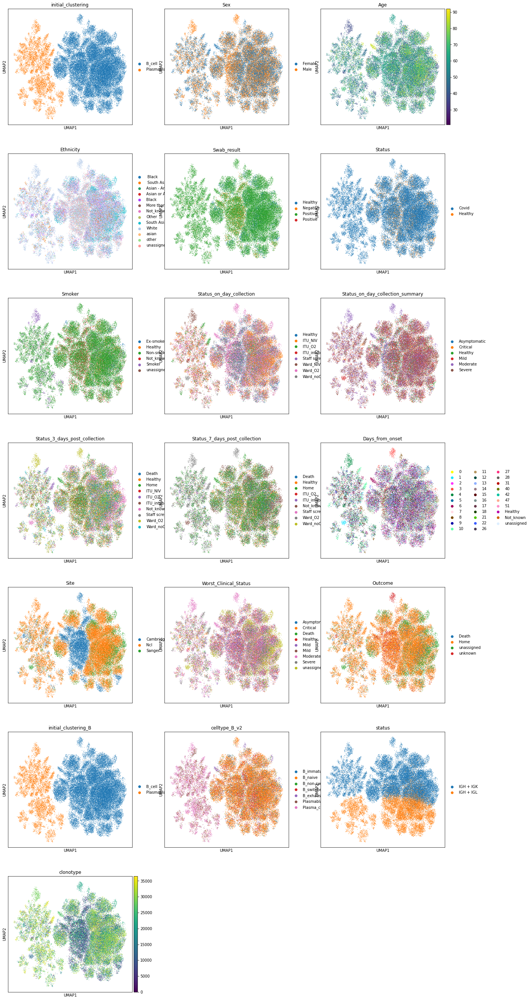

In [9]:
cols = ['initial_clustering', 'Status_on_day_collection_summary', 'celltype_B_v2', 'clonotype']
sc.pl.umap(adata, color=metadata, ncols=3, size=5)
sc.pl.umap(latent_moe, color=metadata, ncols=3, size=5)
sc.pl.umap(latent_rna, color=metadata, ncols=3, size=5)

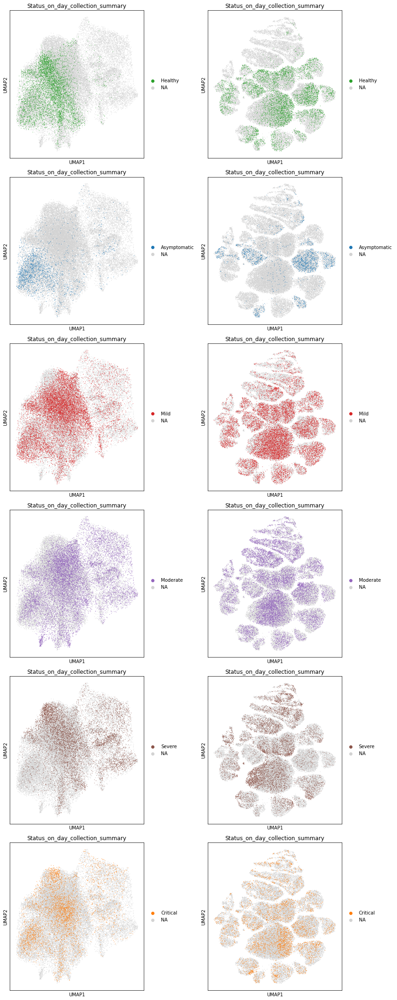

In [10]:
columns = ['Healthy', 'Asymptomatic', 'Mild', 'Moderate', 'Severe', 'Critical']

n_cols = 2
n_rows = len(columns)
fig, axes = plt.subplots(ncols=n_cols, nrows=n_rows, figsize=(6*n_cols, 5*n_rows))
for i, status in enumerate(columns):
    sc.pl.umap(adata, color='Status_on_day_collection_summary', groups=status, size=5, show=False, ax=axes[i][0])
    sc.pl.umap(latent_moe, color='Status_on_day_collection_summary', groups=status, size=5, show=False, ax=axes[i][1])
fig.tight_layout()
plt.show()

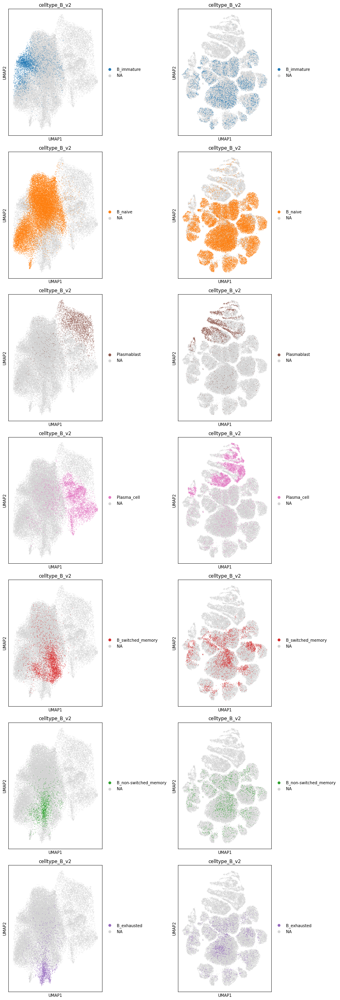

In [11]:
columns = adata.obs['celltype_B_v2'].unique()

n_cols = 2
n_rows = len(columns)
fig, axes = plt.subplots(ncols=n_cols, nrows=n_rows, figsize=(6*n_cols, 5*n_rows))
for i, status in enumerate(columns):
    sc.pl.umap(adata, color='celltype_B_v2', groups=status, size=5, show=False, ax=axes[i][0])
    sc.pl.umap(latent_moe, color='celltype_B_v2', groups=status, size=5, show=False, ax=axes[i][1])
fig.tight_layout()
plt.show()

... storing 'clonotype' as categorical
... storing 'has_34536' as categorical
... storing 'clonotype' as categorical
... storing 'has_34536' as categorical
... storing 'has_12411' as categorical
... storing 'has_12411' as categorical
... storing 'has_26417' as categorical
... storing 'has_26417' as categorical
... storing 'has_21299' as categorical
... storing 'has_21299' as categorical
... storing 'has_28405' as categorical
... storing 'has_28405' as categorical


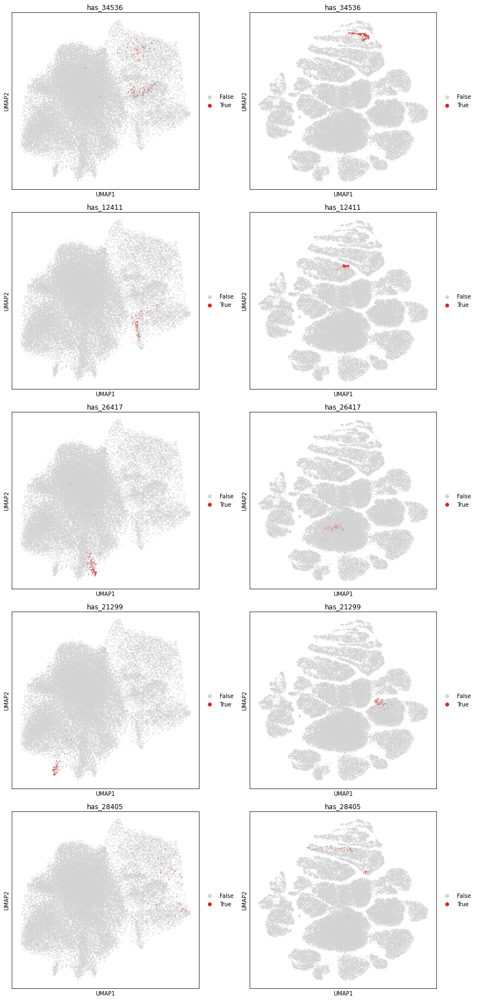

In [17]:
adata.obs['clonotype'] = adata.obs['clonotype'].astype(str)
latent_moe.obs['clonotype'] = latent_moe.obs['clonotype'].astype(str)
columns = adata.obs['clonotype'].value_counts().head(5).keys().tolist()

n_cols = 2
n_rows = len(columns)
fig, axes = plt.subplots(ncols=n_cols, nrows=n_rows, figsize=(6*n_cols, 5*n_rows))
for i, status in enumerate(columns):
    adata.obs[f'has_{status}'] = (adata.obs['clonotype'] == status).astype(str)
    latent_moe.obs[f'has_{status}'] = (latent_moe.obs['clonotype'] == status).astype(str)
    sc.pl.umap(adata, color=f'has_{status}', size=10, show=False, ax=axes[i][0],
              palette={'True': 'tab:red', 'False': 'lightgray'})
    sc.pl.umap(latent_moe, color=f'has_{status}', size=10, show=False, ax=axes[i][1],
               palette={'True': 'tab:red', 'False': 'lightgray'})
fig.tight_layout()
plt.show()

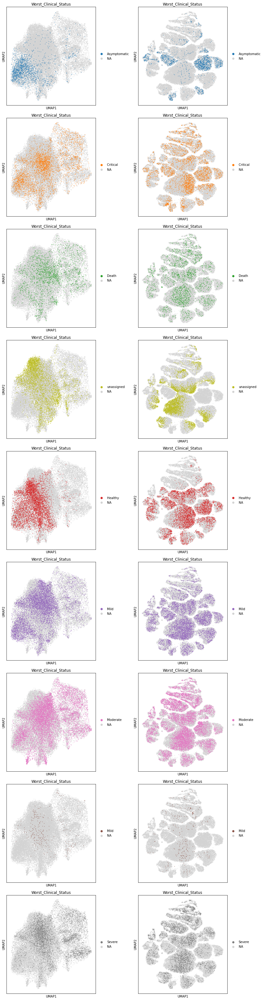

In [18]:
color = 'Worst_Clinical_Status'
columns = adata.obs[color].unique()

n_cols = 2
n_rows = len(columns)
fig, axes = plt.subplots(ncols=n_cols, nrows=n_rows, figsize=(6*n_cols, 5*n_rows))
for i, status in enumerate(columns):
    sc.pl.umap(adata, color=color, groups=status, size=10, show=False, ax=axes[i][0])
    sc.pl.umap(latent_moe, color=color, groups=status, size=10, show=False, ax=axes[i][1])
fig.tight_layout()
plt.show()

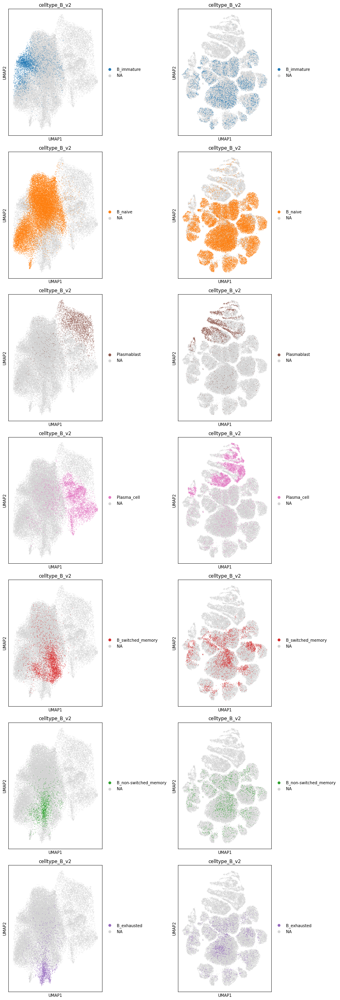

In [20]:
color = 'celltype_B_v2'
columns = adata.obs[color].unique()

n_cols = 2
n_rows = len(columns)
fig, axes = plt.subplots(ncols=n_cols, nrows=n_rows, figsize=(6*n_cols, 5*n_rows))
for i, status in enumerate(columns):
    sc.pl.umap(adata, color=color, groups=status, size=5, show=False, ax=axes[i][0])
    sc.pl.umap(latent_moe, color=color, groups=status, size=5, show=False, ax=axes[i][1])
fig.tight_layout()
plt.show()

In [13]:
def create_scp_comand(trial, model):
    cmd = 'scp -i ~/.ssh/drost_cluster_juelich drost1@juwels-booster.fz-juelich.de:'
    cmd += '/p/project/hai_sctc_can/code/optuna'
    cmd += f'/haniffa_bcr_{model}/trial_{trial}/best_model_by_metric.pt'
    cmd += f' Haniffa_bcells/haniffa_bc_{model}.pt'
    return cmd

In [14]:
best_trials = {
    'moe': 27,
    'rna': 90,
    'tcr': 47
}

for m, t  in best_trials.items():
    cmd = create_scp_comand(t, m)
    print(cmd)
    print('1Legion4u')
    print()

scp -i ~/.ssh/drost_cluster_juelich drost1@juwels-booster.fz-juelich.de:/p/project/hai_sctc_can/code/optuna/haniffa_bcr_moe/trial_27/best_model_by_metric.pt Haniffa_bcells/haniffa_bc_moe.pt
1Legion4u

scp -i ~/.ssh/drost_cluster_juelich drost1@juwels-booster.fz-juelich.de:/p/project/hai_sctc_can/code/optuna/haniffa_bcr_rna/trial_90/best_model_by_metric.pt Haniffa_bcells/haniffa_bc_rna.pt
1Legion4u

scp -i ~/.ssh/drost_cluster_juelich drost1@juwels-booster.fz-juelich.de:/p/project/hai_sctc_can/code/optuna/haniffa_bcr_tcr/trial_47/best_model_by_metric.pt Haniffa_bcells/haniffa_bc_tcr.pt
1Legion4u



In [15]:
def create_scp_weight_comand(trial, model, weight):
    cmd = 'scp -i ~/.ssh/drost_cluster_juelich drost1@juwels-booster.fz-juelich.de:'
    cmd += '/p/project/hai_sctc_can/code/optuna'
    cmd += f'/haniffa_bcr_{model}_{weight}/trial_{trial}/best_model_by_metric.pt'
    cmd += f' Haniffa_bcells/haniffa_bc_{model}_{weight}.pt'
    return cmd

In [16]:
trials_weight = {
    3: 25,
    5: 36,
    10: 30,
}

for w, t in trials_weight.items():
    cmd = create_scp_weight_comand(t, 'moe', w)
    print(cmd)
    print('1Legion4u')
    print()

scp -i ~/.ssh/drost_cluster_juelich drost1@juwels-booster.fz-juelich.de:/p/project/hai_sctc_can/code/optuna/haniffa_bcr_moe_3/trial_25/best_model_by_metric.pt Haniffa_bcells/haniffa_bc_moe_3.pt
1Legion4u

scp -i ~/.ssh/drost_cluster_juelich drost1@juwels-booster.fz-juelich.de:/p/project/hai_sctc_can/code/optuna/haniffa_bcr_moe_5/trial_36/best_model_by_metric.pt Haniffa_bcells/haniffa_bc_moe_5.pt
1Legion4u

scp -i ~/.ssh/drost_cluster_juelich drost1@juwels-booster.fz-juelich.de:/p/project/hai_sctc_can/code/optuna/haniffa_bcr_moe_10/trial_30/best_model_by_metric.pt Haniffa_bcells/haniffa_bc_moe_10.pt
1Legion4u

